#**Homework 2: Influence in Networks – Global Arms Trade Network**

- **Name:** Salman Hussain
- **Course:** Games and Decisions in Data Analysis and Modelling
- **Date:** April 8, 2025

###**Know Your Data**
This dataset captures global arms transfers between countries from 2000–2023.
It contains 'source' (exporter), 'target' (importer), and 'quantity' (weapons transferred).

In [20]:
# import libraries
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

## Load and Inspect the Dataset

We begin by loading the real-world dataset: **`global_arms_transfer_2000_2023.csv`**, which contains records of international arms transfers over a 23-year span (2000–2023).

### Initial Data Exploration
- `df.head()` displays the first few rows to help us understand the structure of the dataset.
- `df.isnull().sum()` gives us an overview of missing values in each column, which is essential for guiding our data cleaning strategy.

This initial inspection helps us understand:
- What each column represents (e.g., `source`, `target`, `quantity`, etc.)
- Where cleaning is needed
- The shape and scope of the dataset before we begin modeling it as a network


In [21]:
# Load and Inspect Data
file_path = "global_arms_transfer_2000_2023.csv"
df = pd.read_csv(file_path)
print("Initial Data Preview:")
print(df.head())
print("\nMissing Values:")
print(df.isnull().sum())

Initial Data Preview:
       id  trade_id                target               source  \
0  230885       551            Kyrgyzstan               Russia   
1  252527      1452  unknown rebel group*  unknown supplier(s)   
2  272485      2511              Paraguay                Spain   
3  273685      3509                Greece        United States   
4  240855      4031                NATO**        United States   

                  order_date orderYrEst  quantity              delivery_date  \
0  2005-01-01 00:00:00+00:00       True       1.0  2005-01-01 00:00:00+00:00   
1  2002-01-01 00:00:00+00:00       True       1.0  2002-01-01 00:00:00+00:00   
2  2003-01-01 00:00:00+00:00      False       1.0  2004-01-01 00:00:00+00:00   
3  2003-01-01 00:00:00+00:00      False       4.0  2007-01-01 00:00:00+00:00   
4  2012-01-01 00:00:00+00:00      False       5.0  2020-01-01 00:00:00+00:00   

      designation           description  category  source_lat  source_lng  \
0           Mi-17  tran

## Data Cleaning and Preprocessing

Before constructing our network, we need to ensure the dataset is clean and consistent:

### Actions Performed:
1. **Remove Missing Nodes**:
   - Rows with `NaN` values in either the `source` or `target` columns are dropped. These represent incomplete transfer records and can't be used to form network edges.

2. **Exclude Non-Country Entities**:
   - Some rows contain values like `"unknown"` or `"unspecified"` as `source` or `target`. These are not meaningful country-level entities, so they are filtered out using `.str.contains()`.

3. **Sanitize Transfer Quantities**:
   - The `quantity` column, which represents the volume of arms transferred, is:
     - Converted to numeric (using `pd.to_numeric`)
     - Invalid or missing values are replaced with `1.0` (minimum assumed trade unit)

### Output:
The `df_clean.describe()` summary shows statistical insight into cleaned data such as:
- Number of records
- Distribution of quantities
- Readiness for network modeling

Cleaning ensures that the graph structure accurately represents **meaningful, directed, weighted arms transfers** between actual countries.


In [22]:
# Data Cleaning and Preprocessing
# Drop rows with missing or unspecified entities
df_clean = df.dropna(subset=['source', 'target'])
df_clean = df_clean[
    ~df_clean['source'].str.lower().str.contains("unknown|unspecified") &
    ~df_clean['target'].str.lower().str.contains("unknown|unspecified")
]
df_clean['quantity'] = pd.to_numeric(df_clean['quantity'], errors='coerce').fillna(1.0)

print("\nAfter Cleaning:")
print(df_clean.describe())


After Cleaning:
                  id      trade_id      quantity    source_lat    source_lng  \
count   10327.000000  10327.000000  10327.000000  10297.000000  10297.000000   
mean   272954.576837  52401.638811    106.957684     42.087562      1.007558   
std     30367.250904  12115.611673    639.991658     16.388005     63.674359   
min    229360.000000    551.000000      0.000000    -41.887731   -102.758056   
25%    247887.000000  39719.500000      3.000000     38.893651    -77.170630   
50%    263439.000000  56155.000000     10.000000     39.112097     10.298068   
75%    307222.000000  62169.000000     43.000000     51.247366     35.005887   
max    317564.000000  67546.000000  25000.000000     64.919438    172.575618   

         target_lat    target_lng  
count  10022.000000  10022.000000  
mean      25.181105     33.293427  
std       22.578902     56.561128  
min      -41.887731   -102.758056  
25%       12.319989      7.999782  
50%       26.607108     31.197760  
75%       

## Data Integration – Create Weighted Edge List

After cleaning, we now integrate the data to summarize total arms transfers between each country pair.

### Grouping Transfer Records:
- Each row in the dataset represents an individual arms transfer.
- However, countries may exchange multiple shipments over time.
- To build a network, we **aggregate** these multiple transfers between the same `source` and `target`.

### Aggregation Logic:
- We group the data by `['source', 'target']`
- We sum their `quantity` to compute a **total trade volume (weight)** between each country pair

### Result:
The resulting **edge list** contains:
- `source`: exporting country
- `target`: importing country
- `weight`: total volume of arms transferred from source to target

This edge list is a core input for constructing a **directed, weighted network**, where edge weights reflect the **strength or significance** of bilateral trade.

In [23]:
# Data Integration (Summarize weighted edge list)
edges = df_clean.groupby(['source', 'target'])['quantity'].sum().reset_index()
edges.columns = ['source', 'target', 'weight']

## Network Construction

We now build the **directed weighted network graph** using the `networkx` library.

### Graph Structure:
- We use `nx.DiGraph()` to create a **directed graph** because arms transfers flow **from exporter (source) to importer (target)**.
- Each node represents a **country**.
- Each directed edge represents an **arms transfer**, with an associated **weight** (total quantity transferred).

### Edge Creation:
- We iterate over the summarized edge list (`edges`) and add each pair to the graph with:
  - `source → target` direction
  - `weight` as edge attribute

### Network Summary:
- `G.number_of_nodes()`: Total unique countries involved in arms transfers
- `G.number_of_edges()`: Unique trade relationships (exporter → importer)

This structure forms the basis for applying **centrality measures** to assess influence, trade dominance, and connectivity in the global arms trade network.

In [24]:
# Network Construction
G = nx.DiGraph()
for _, row in edges.iterrows():
    G.add_edge(row['source'], row['target'], weight=row['weight'])

print(f"Nodes: {G.number_of_nodes()}, Edges: {G.number_of_edges()}")

Nodes: 202, Edges: 1957


## Centrality Measures (Based on Lecture Formulas)

We compute several centrality measures to identify **influential countries** in the global arms trade network. Each centrality reflects a different concept of importance and follows the formulas discussed in the lecture.


### In-Degree Centrality
Measures how many countries send arms to a given country.

**Formula:**
$$
C_D^-(v) = \frac{deg^-(v)}{n-1}
$$

- High values indicate major **arms importers**.


### Out-Degree Centrality
Measures how many countries a given country exports arms to.

**Formula:**
$$
C_D^+(v) = \frac{deg^+(v)}{n-1}
$$

- High values indicate major **arms exporters**.


### Betweenness Centrality (Weighted)
Indicates how often a country lies on the shortest trade paths between other countries.

**Formula:**
$$
B_i = \sum_{u \neq v \neq i} \frac{\sigma_{uv}(i)}{\sigma_{uv}}
$$

- High values show **strategic intermediaries** or **bridge countries**.


### Closeness Centrality (Inverse Weighted)
Shows how efficiently a country can reach all other countries in the network.

**Formula:**
$$
C_i = \frac{1}{\sum_j d_{ij}}
$$

- We use **inverse of weight** to treat high-volume transfers as "closer" relationships.

### Eigenvector Centrality (Weighted)
Measures a country's influence based on the influence of its neighbors.
**Formula:**
$$
Ax = \lambda x
$$

- High values mean the country is connected to other **highly influential nodes**.

### PageRank Centrality (Weighted)
Captures influence through a recursive, flow-based model (like Google's algorithm).

**Formula:**
$$
x_i = \alpha \sum_j \frac{A_{ij} x_j}{n_j} + \beta
$$

- Values reflect **importance based on the structure of arms trade flows**.

All results are stored in a combined `pandas` DataFrame for later visualization and analysis.


In [25]:
# Centrality Measures (According to Lecture Formulas)
in_deg = nx.in_degree_centrality(G)
out_deg = nx.out_degree_centrality(G)

# Weighted metrics
betweenness = nx.betweenness_centrality(G, weight='weight')
eigen = nx.eigenvector_centrality(G, weight='weight')
pagerank = nx.pagerank(G, weight='weight')

# Closeness with inverse weight
g_inv = G.copy()
for u, v, d in g_inv.edges(data=True):
    d['weight'] = 1 / d['weight'] if d['weight'] > 0 else 0
closeness = nx.closeness_centrality(g_inv, distance='weight')
# Combine Metrics
data = pd.DataFrame({
    'Country': list(G.nodes),
    'In-Degree': [in_deg[n] for n in G.nodes()],
    'Out-Degree': [out_deg[n] for n in G.nodes()],
    'Betweenness': [betweenness[n] for n in G.nodes()],
    'Closeness': [closeness[n] for n in G.nodes()],
    'Eigenvector': [eigen[n] for n in G.nodes()],
    'PageRank': [pagerank[n] for n in G.nodes()],
})

## Tabular and Graphical Results

Below we present the **Top 10 countries** ranked by each centrality measure used in this network analysis.

Each metric highlights a different form of influence in the global arms transfer network:

- **Out-Degree (Top Exporters):** Countries that export arms to the largest number of distinct countries.
- **In-Degree (Top Importers):** Countries that import arms from the largest number of sources.
- **Betweenness (Trade Bridges):** Countries that frequently lie on the shortest paths between others — serving as brokers or intermediaries.
- **Closeness (Trade Efficiency):** Countries that can reach all other countries quickly (based on volume-adjusted shortest paths).
- **Eigenvector (Influence via Network):** Countries that are connected to other influential countries.
- **PageRank (Flow-based Importance):** A recursive influence measure reflecting how likely arms trade would flow through each country.

For each metric, we display:
- A table of the **Top 10 countries**
- A horizontal bar plot using a blue color gradient (**higher values = darker blue**)

This helps us understand and compare the **varied dimensions of influence** that exist in the global arms trade system.


Top 10 Countries by Out-Degree:
            Country  Out-Degree
47    United States    0.676617
57           France    0.532338
147          Russia    0.472637
59          Germany    0.447761
130           Italy    0.447761
14           Canada    0.412935
129          Israel    0.407960
85            China    0.398010
72            Spain    0.373134
46   United Kingdom    0.363184


<ipython-input-26-c012418a8c7a>:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=metric, y='Country', data=top10, palette='Blues_r')


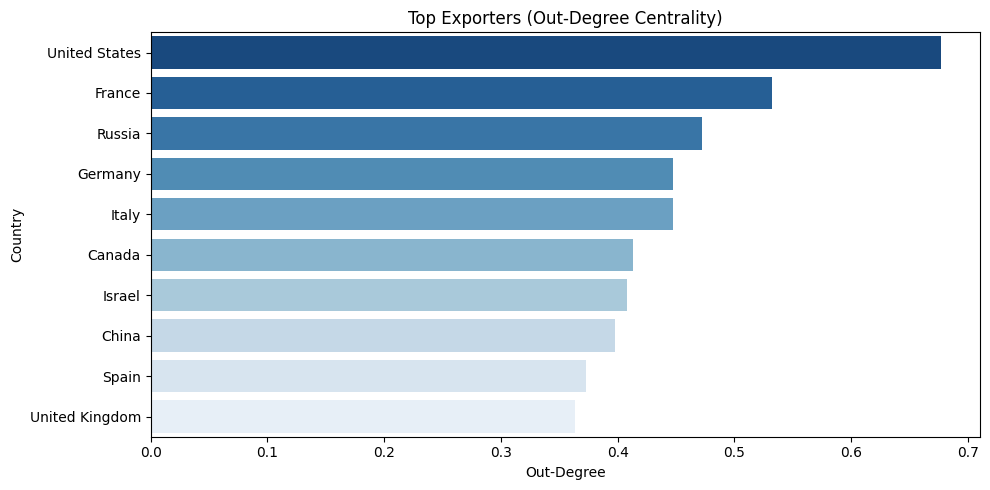

Top 10 Countries by In-Degree:
           Country  In-Degree
9          Ukraine   0.169154
45             UAE   0.144279
19       Indonesia   0.139303
47   United States   0.139303
20            Iraq   0.134328
26        Malaysia   0.134328
103       Pakistan   0.129353
66         Nigeria   0.124378
70    Saudi Arabia   0.124378
35     Philippines   0.114428


<ipython-input-26-c012418a8c7a>:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=metric, y='Country', data=top10, palette='Blues_r')


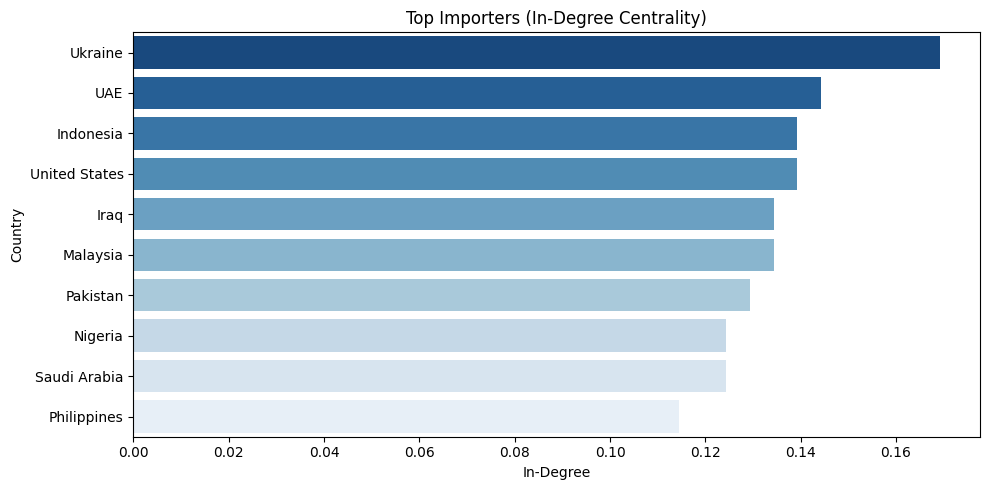

Top 10 Countries by Betweenness:
           Country  Betweenness
14          Canada     0.128182
47   United States     0.089593
45             UAE     0.082631
147         Russia     0.077598
79         Denmark     0.067672
9          Ukraine     0.060829
54          Brazil     0.057971
30     Netherlands     0.054256
136        Romania     0.042591
6        Argentina     0.038325


<ipython-input-26-c012418a8c7a>:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=metric, y='Country', data=top10, palette='Blues_r')


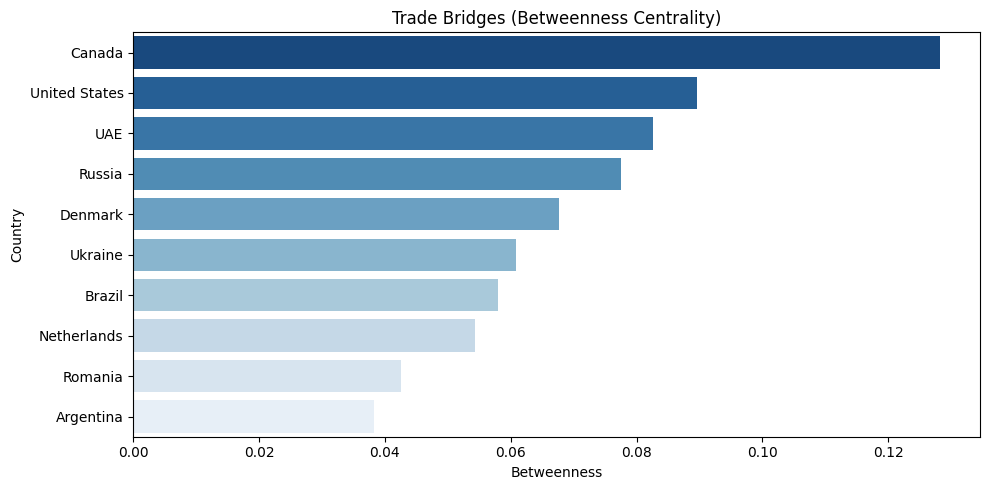

Top 10 Countries by Closeness:
         Country  Closeness
107     Colombia   2.083718
115       Mexico   2.076361
92          Peru   1.991660
4         Angola   1.884265
35   Philippines   1.882221
11       Armenia   1.869855
26      Malaysia   1.851042
80       Bahrain   1.803658
20          Iraq   1.801869
64       Myanmar   1.800016


<ipython-input-26-c012418a8c7a>:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=metric, y='Country', data=top10, palette='Blues_r')


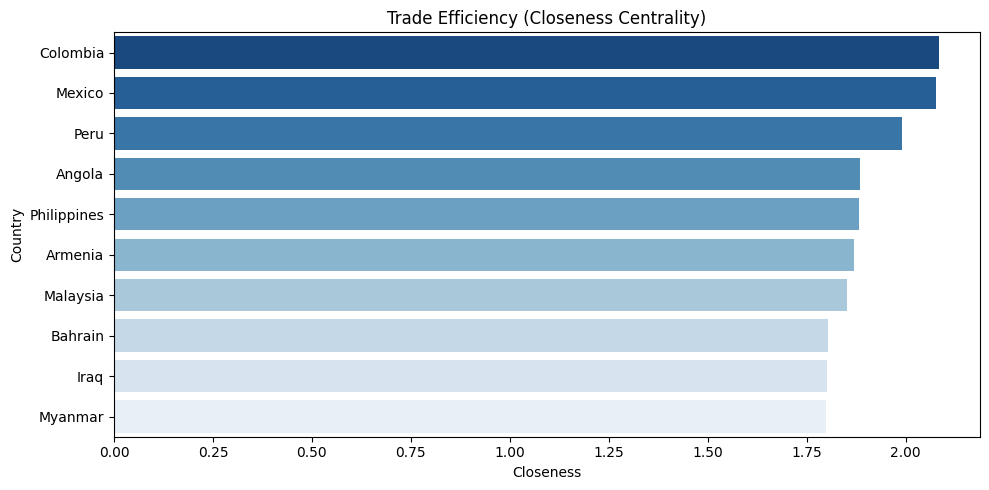

Top 10 Countries by Eigenvector:
            Country  Eigenvector
70     Saudi Arabia     0.545280
9           Ukraine     0.494232
68           Poland     0.317441
45              UAE     0.270672
129          Israel     0.217295
20             Iraq     0.192051
46   United Kingdom     0.166251
18            India     0.134573
13        Australia     0.118757
56            Egypt     0.118101


<ipython-input-26-c012418a8c7a>:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=metric, y='Country', data=top10, palette='Blues_r')


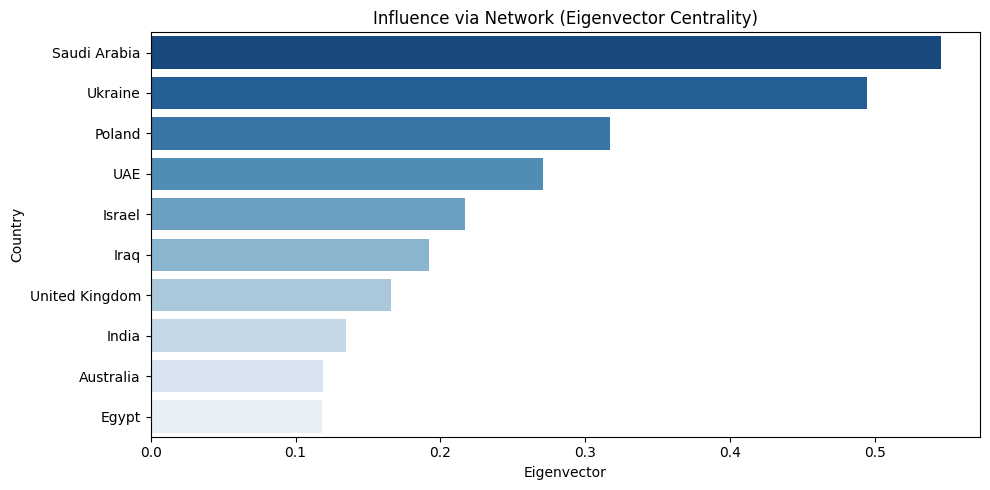

Top 10 Countries by PageRank:
          Country  PageRank
9         Ukraine  0.039715
70   Saudi Arabia  0.024843
103      Pakistan  0.023427
26       Malaysia  0.022027
7         Bolivia  0.019345
73       Thailand  0.018064
10        Uruguay  0.017381
45            UAE  0.016965
49          Yemen  0.016006
1    Burkina Faso  0.015303


<ipython-input-26-c012418a8c7a>:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=metric, y='Country', data=top10, palette='Blues_r')


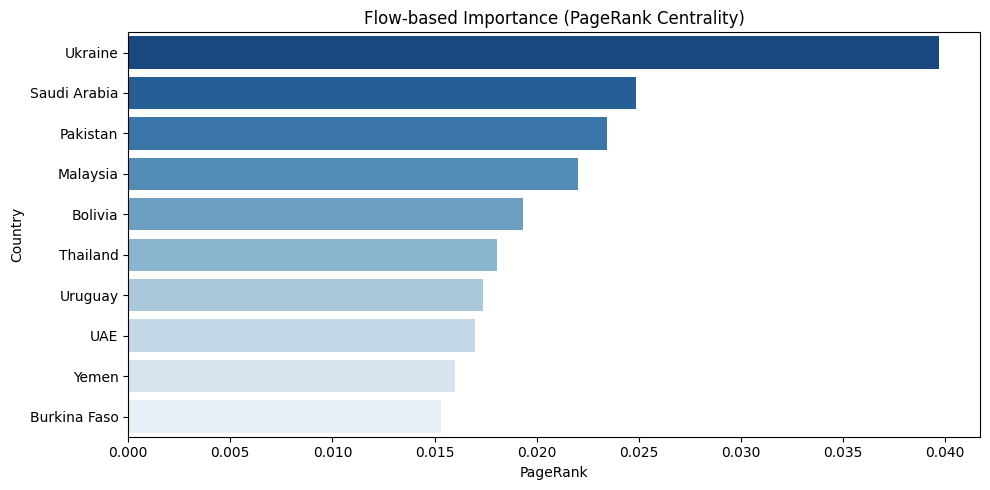

In [26]:
# Tabular and Graphical Results

metric_titles = [
    ('Out-Degree', 'Top Exporters'),
    ('In-Degree', 'Top Importers'),
    ('Betweenness', 'Trade Bridges'),
    ('Closeness', 'Trade Efficiency'),
    ('Eigenvector', 'Influence via Network'),
    ('PageRank', 'Flow-based Importance')
]

for metric, label in metric_titles:
    top10 = data.sort_values(by=metric, ascending=False).head(10)
    print(f"Top 10 Countries by {metric}:")
    print(top10[['Country', metric]])
    plt.figure(figsize=(10, 5))
    sns.barplot(x=metric, y='Country', data=top10, palette='Blues_r')
    plt.title(f"{label} ({metric} Centrality)")
    plt.tight_layout()
    plt.show()

## Centrality Score Distributions

To better understand how each centrality metric is distributed across the network, we generate histograms for:

- **Out-Degree**
- **In-Degree**
- **Betweenness**
- **Closeness**
- **Eigenvector**
- **PageRank**

These histograms allow us to:
- Detect skewed distributions (e.g., a few highly influential countries)
- Spot outliers or central hubs
- Compare the relative spread and concentration of scores

Each plot shows the frequency of countries falling within different score ranges for a given centrality. Most centrality measures are right-skewed, indicating a **small number of highly influential countries** dominate arms transfers globally.


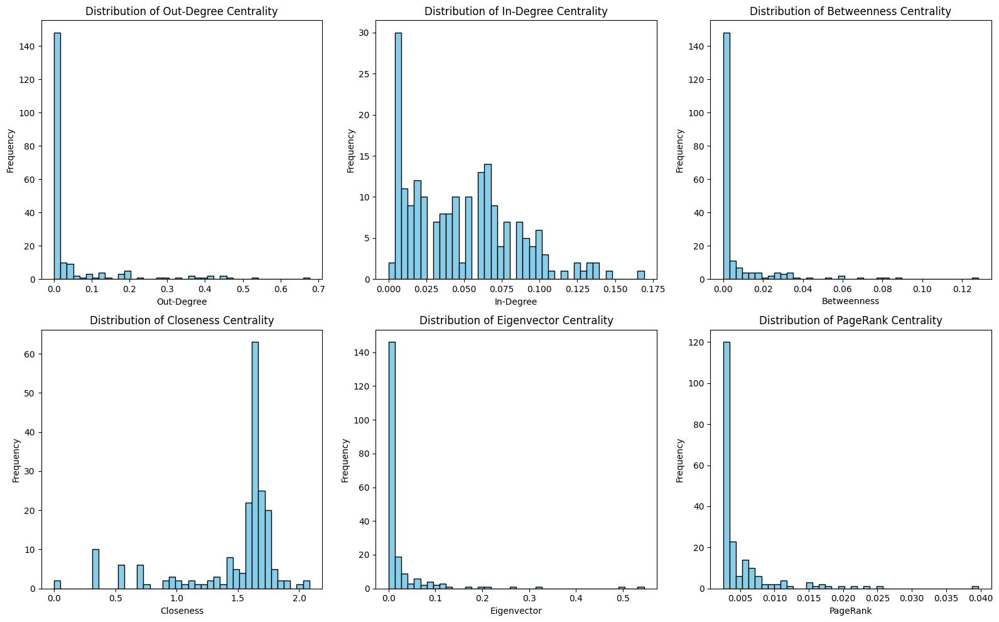

In [27]:
# Histograms for Distribution

metrics = [m[0] for m in metric_titles]
plt.figure(figsize=(16, 10))
for i, metric in enumerate(metrics):
    plt.subplot(2, 3, i+1)
    plt.hist(data[metric], bins=40, color='skyblue', edgecolor='black')
    plt.title(f"Distribution of {metric} Centrality")
    plt.xlabel(metric)
    plt.ylabel('Frequency')
plt.tight_layout()
plt.show()

## Network Visualizations (Red Gradient for Influence)

To complement the tabular and graphical results, we visualize the entire global arms transfer network using different centrality scores.

Each graph helps us **see influence structurally** in the network, with the following visual cues:

### Node Representation
- **Node Size**: Proportional to the centrality score
- **Node Color**: Dark red = high influence, Light red = low influence (via `'Reds'` color map)

### Edge Representation
- **Edge Direction**: Arrows indicate the flow from exporter → importer
- **Edge Width**:
  - **Weighted Metrics** (Betweenness, Closeness, Eigenvector, PageRank): edge thickness is scaled by arms volume
  - **Unweighted Metrics** (In-Degree, Out-Degree): fixed edge thickness for visual clarity

### Layout
A spring layout (`nx.spring_layout`) is used for optimal separation of nodes and aesthetic readability.

Each plot corresponds to one of the following metrics:
- Out-Degree: Top exporters
- In-Degree: Top importers
- Betweenness: Strategic bridge countries
- Closeness: Efficiency of trade reach
- Eigenvector: Influence by connection
- PageRank: Flow-based global importance

These visualizations provide insight not just into rankings but into the **geopolitical structure** of global arms trade influence.


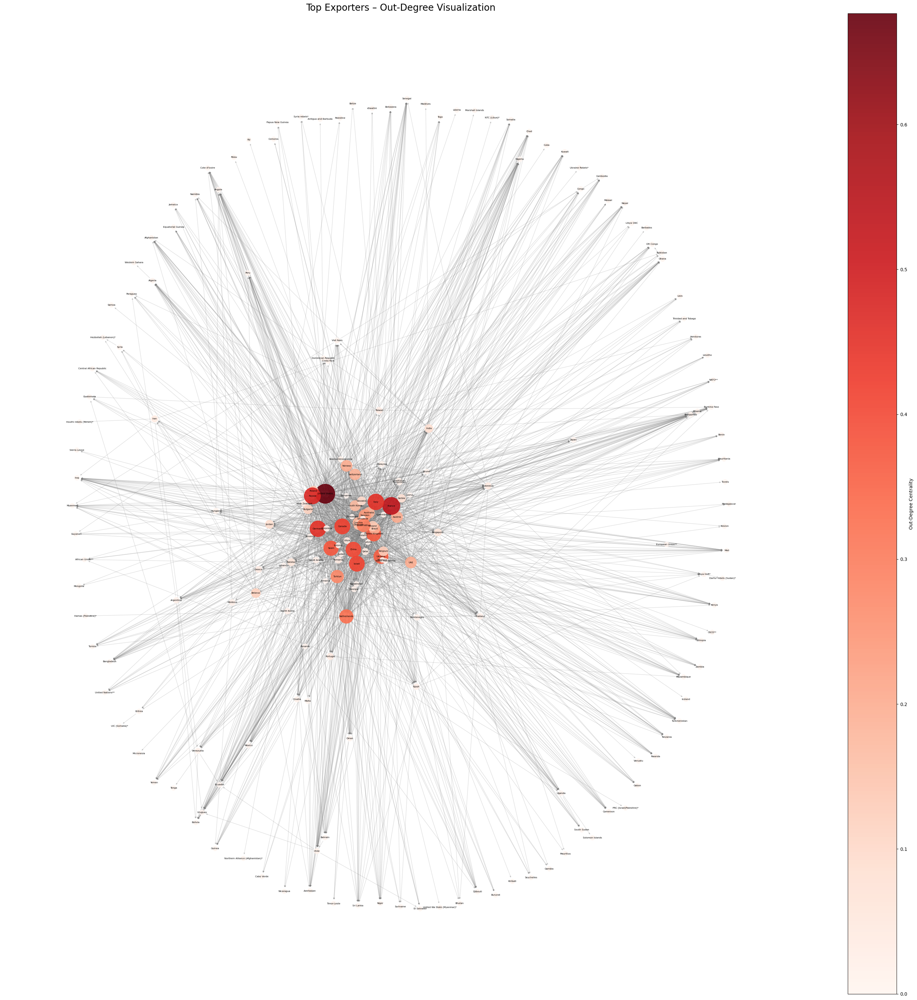

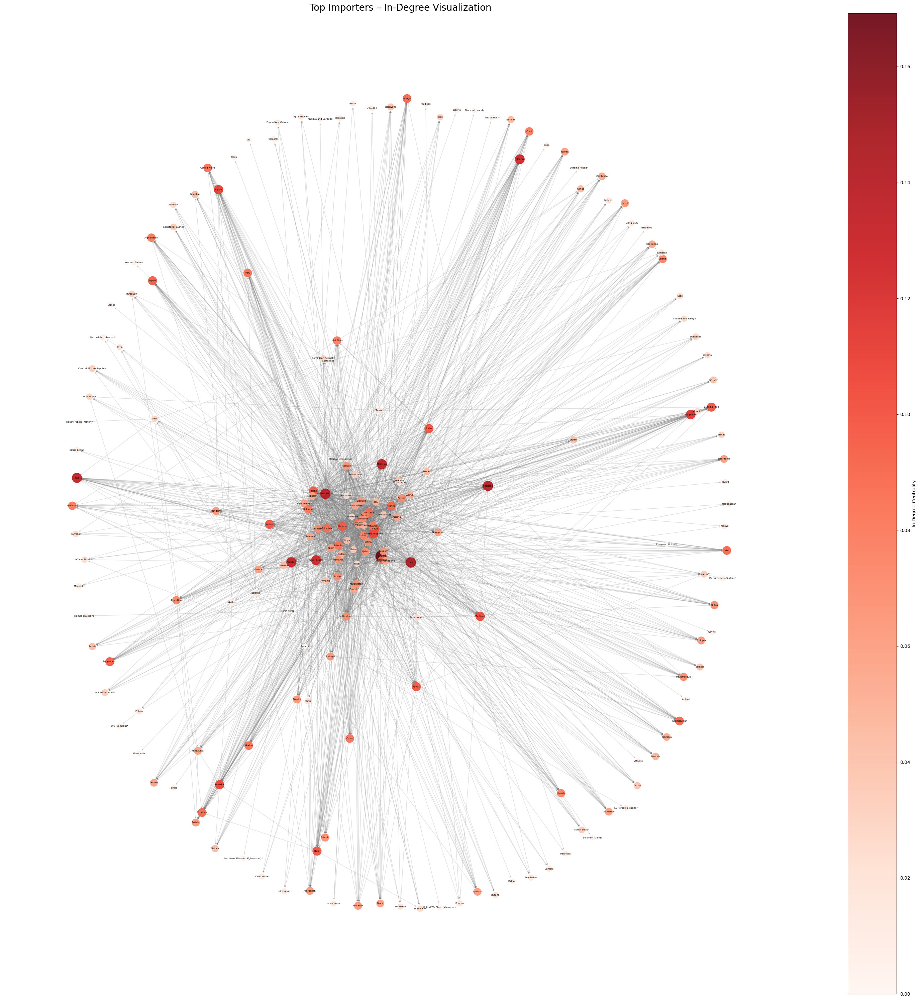

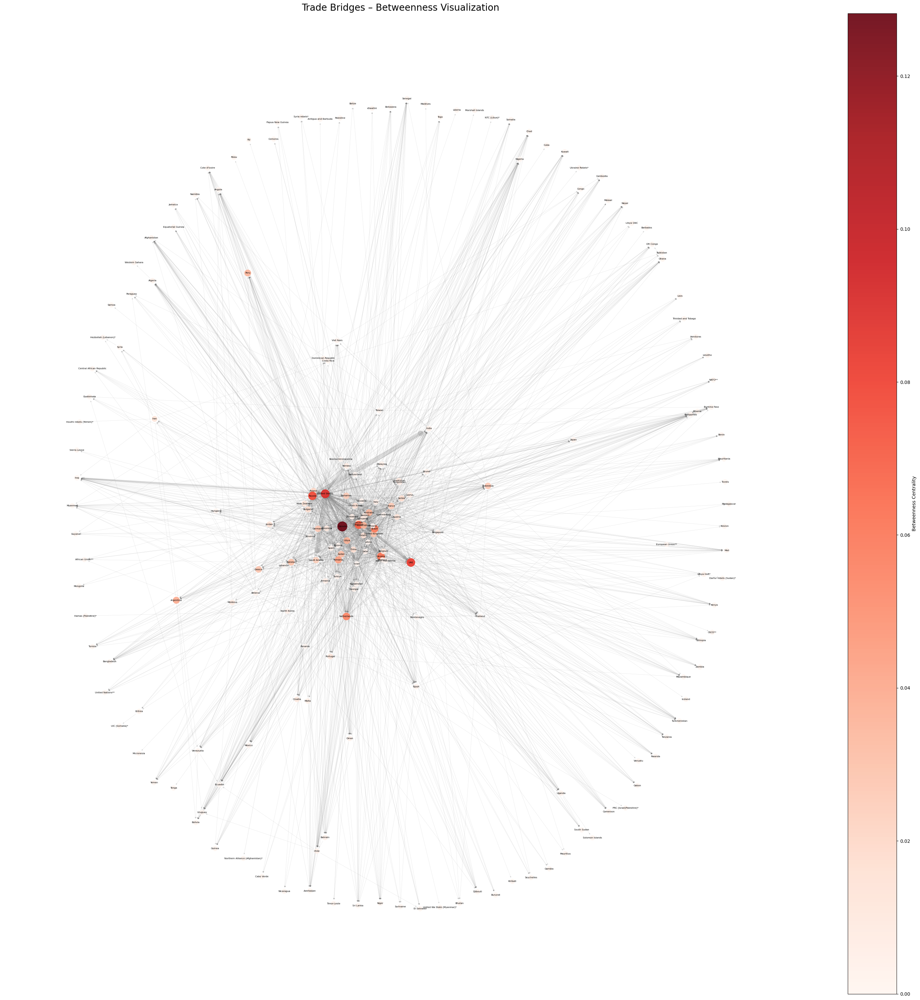

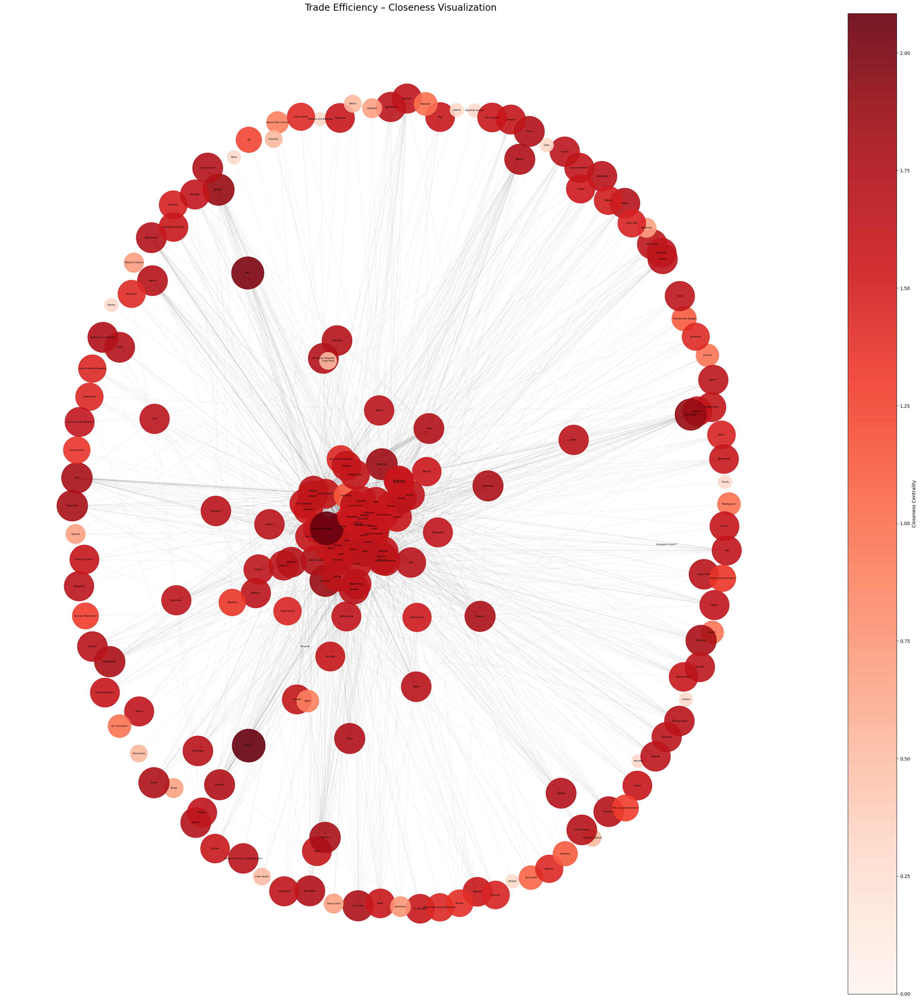

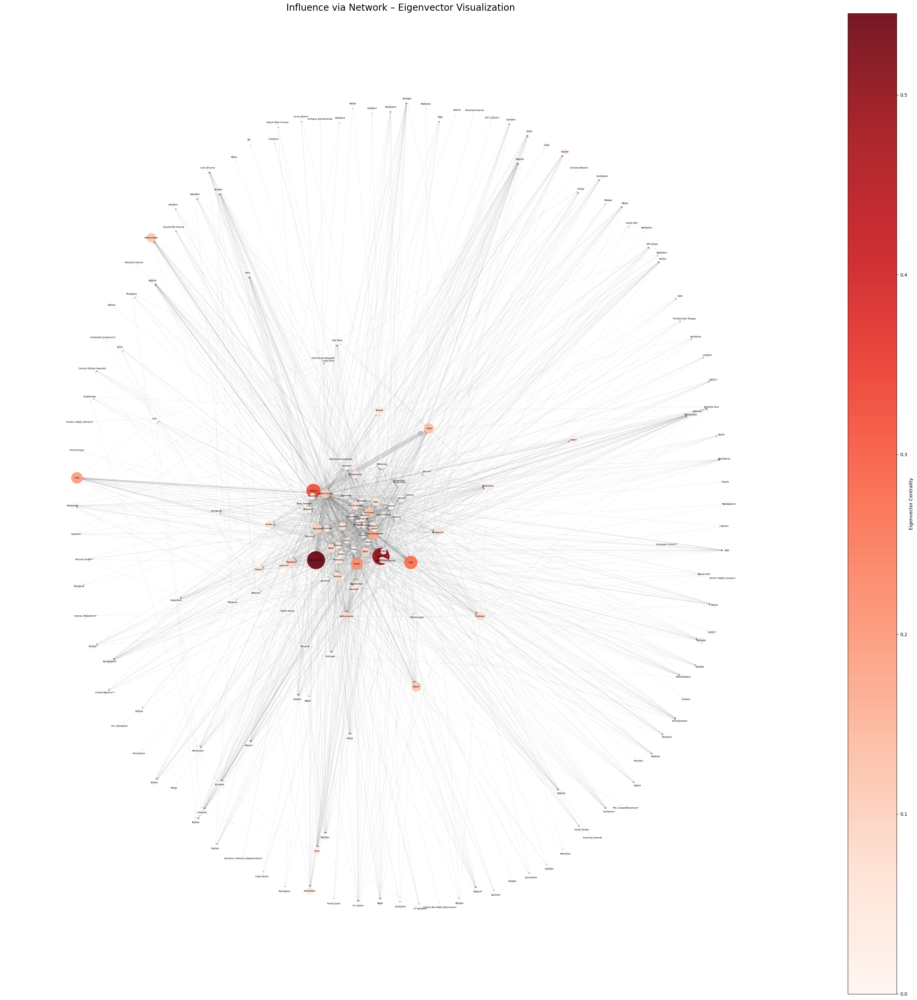

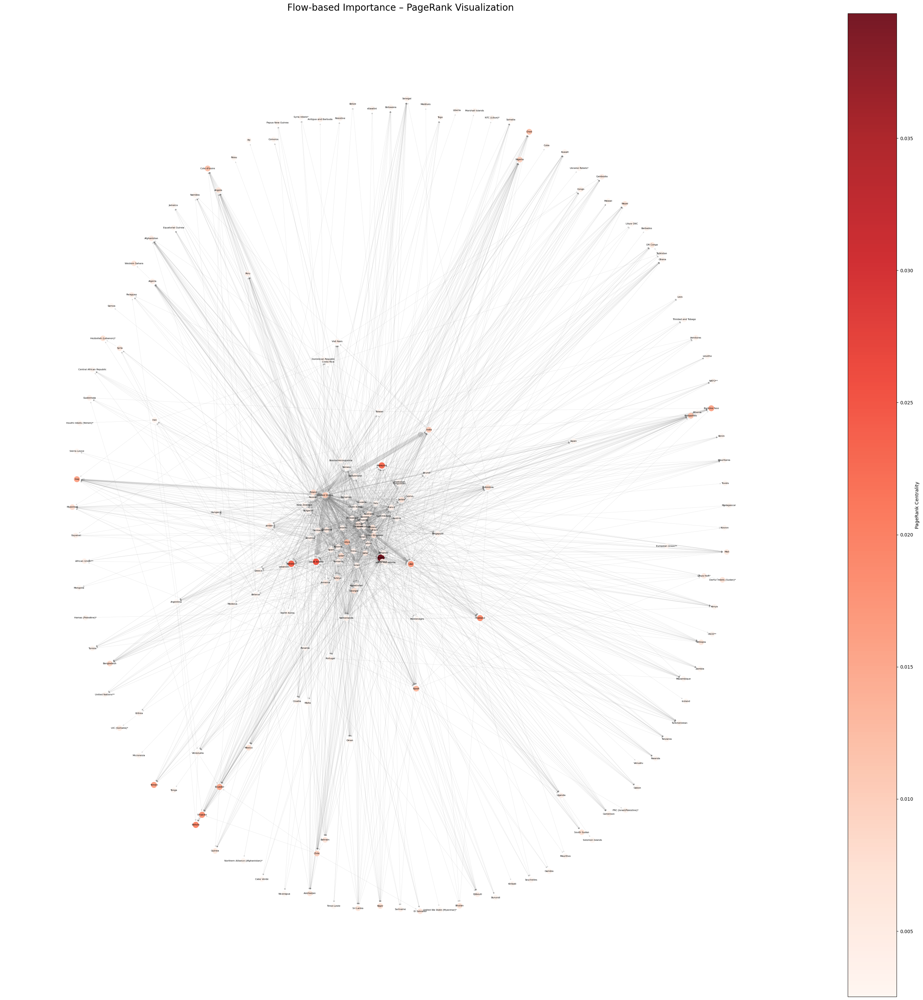

In [28]:
# Network Visualizations (Red Color Gradient for Influence)

layout = nx.spring_layout(G, k=0.3, iterations=200, seed=42)
min_size, max_size = 100, 2500

for metric, label in metric_titles:
    scores = data.set_index('Country')[metric].to_dict()
    node_sizes = [min_size + (max_size - min_size) * scores[n] for n in G.nodes()]
    node_colors = [scores[n] for n in G.nodes()]
    # Use fixed edge width for unweighted metrics and actual weight for weighted ones
    use_weight = metric in ['Betweenness', 'Closeness', 'Eigenvector', 'PageRank']
    if use_weight:
        edge_weights = [0.4 + (G[u][v]['weight'] / df_clean['quantity'].max()) * 3 for u, v in G.edges()]
    else:
        edge_weights = [1 for _ in G.edges()]

    plt.figure(figsize=(30, 30))
    nodes = nx.draw_networkx_nodes(G, layout, node_size=node_sizes, node_color=node_colors, cmap='Reds', alpha=0.9)
    nx.draw_networkx_edges(G, layout, width=edge_weights, alpha=0.25, edge_color='gray', arrows=True, arrowsize=6)
    nx.draw_networkx_labels(G, layout, font_size=5, font_color='black')
    plt.colorbar(nodes, label=f'{metric} Centrality')
    plt.title(f"{label} – {metric} Visualization", fontsize=20)
    plt.axis('off')
    plt.tight_layout()
    plt.show()

## Correlation Between Centrality Measures

To explore the relationships between different centrality metrics, we generate a correlation heatmap.

### What This Shows:
- **Each cell** in the heatmap represents the **Pearson correlation coefficient** between a pair of centrality measures.
- A **higher correlation** (closer to 1) indicates that the two metrics rank countries similarly.
- A **lower correlation** (closer to 0) suggests that the metrics capture different types of influence in the network.

### Color Scale:
- Darker blue = stronger positive correlation
- Lighter blue = weaker correlation

### Why It Matters:
Understanding correlations helps us:
- Detect **redundant metrics**
- Interpret **differences in influence**
- Choose the **most informative centralities** when simplifying or summarizing the network

This visual supports a **deeper analytical interpretation** beyond individual rankings.


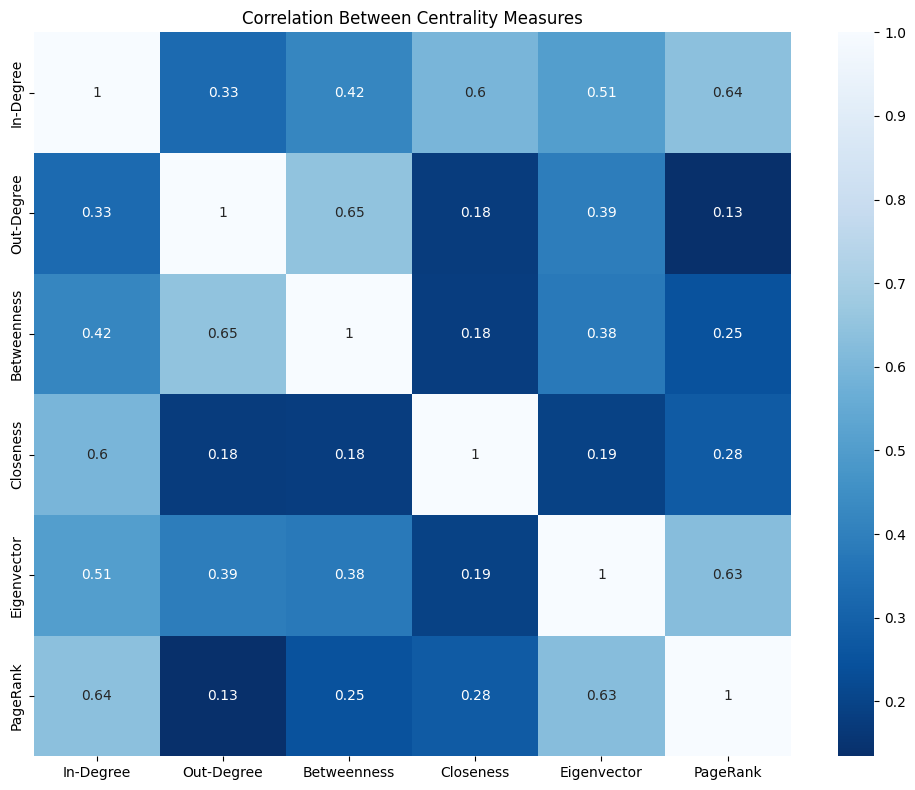

In [29]:
# Correlation Between Centrality Measures
plt.figure(figsize=(10, 8))
sns.heatmap(data.drop('Country', axis=1).corr(), annot=True, cmap='Blues_r')
plt.title("Correlation Between Centrality Measures")
plt.tight_layout()
plt.show()